In [ ]:
#MODEL
import os
import sys
os.environ["KERAS_BACKEND"] = "tensorflow"
os.environ['XLA_FLAGS'] = '--xla_gpu_strict_conv_algorithm_picker=false'

import numpy as np
import tensorflow as tf
from tensorflow import keras
from keras import ops
from keras import layers


from PIL import Image
import matplotlib.pyplot as plt

from keras import utils, models
from keras.layers import Rescaling
from keras.applications.vgg19 import VGG19
from keras.applications.vgg19 import preprocess_input


print('keras: ', keras.__version__)
print('tensorflow: ',tf.__version__)
print('python: ',sys.version)
print(tf.version.GIT_VERSION, tf.version.VERSION)

print("Num GPUs Available: ", len(tf.config.list_physical_devices('GPU')))

#####CONFIGS#####
Train = True
epochs = 100
latent_dim = 512
BATCH_SIZE_PER_REPLICA = 64
###################


strategy = tf.distribute.MirroredStrategy()
print('Number of devices: {}'.format(strategy.num_replicas_in_sync))


BATCH_SIZE = BATCH_SIZE_PER_REPLICA * strategy.num_replicas_in_sync


class Sampling(layers.Layer):
    """Uses (z_mean, z_log_var) to sample z, the vector encoding a face."""

    def __init__(self, **kwargs):
        super().__init__(**kwargs)
        self.seed_generator = keras.random.SeedGenerator(280602)

    def call(self, inputs):
        z_mean, z_log_var = inputs
        batch = ops.shape(z_mean)[0]
        dim = ops.shape(z_mean)[1]
        epsilon = keras.random.normal(shape=(batch, dim), seed=self.seed_generator)
        return z_mean + ops.exp(0.5 * z_log_var) * epsilon
    
def create_encoder(input_shape=(128, 128, 3), latent_dim=512):
    inputs = keras.Input(shape=input_shape)
    
    
    x = layers.Conv2D(64, (4,4), activation='leaky_relu', strides=2, padding='same')(inputs)
    x = layers.BatchNormalization()(x)
    x = layers.Dropout(0.2)(x)
    
    x = layers.Conv2D(128, (4,4), activation='leaky_relu', strides=2, padding='same')(x)
    x = layers.BatchNormalization()(x)
    x = layers.Dropout(0.2)(x)
    
    x = layers.Conv2D(256, (4,4), activation='leaky_relu', strides=2, padding='same')(x)
    x = layers.BatchNormalization()(x)
    x = layers.Dropout(0.2)(x)
    
    x = layers.Conv2D(512, (4,4), activation='leaky_relu', strides=2, padding='same')(x)
    x = layers.BatchNormalization()(x)
    x = layers.Dropout(0.2)(x)
    
    x = layers.Flatten()(x)
    
    # Add dense layers before final latent space
    x = layers.Dense(512, activation='leaky_relu')(x)
    x = layers.BatchNormalization()(x)
    x = layers.Dropout(0.2)(x)
    
    z_mean = layers.Dense(latent_dim, name='z_mean')(x)
    z_log_var = layers.Dense(latent_dim, name='z_log_var')(x)
    z = Sampling()([z_mean, z_log_var])
    
    return keras.Model(inputs, [z_mean, z_log_var, z], name='improved_encoder')


def create_decoder(latent_dim=512):
    latent_inputs = keras.Input(shape=(latent_dim,))
    
    x = layers.Dense(8*8*512, activation='leaky_relu')(latent_inputs)
    x = layers.Reshape((8, 8, 512))(x)
    
    x = layers.Conv2DTranspose(256, (4,4), activation='leaky_relu', strides=2, padding='same')(x)
    x = layers.BatchNormalization()(x)
    
    x = layers.Conv2DTranspose(128, (4,4), activation='leaky_relu', strides=2, padding='same')(x)
    x = layers.BatchNormalization()(x)
    
    x = layers.Conv2DTranspose(64, (4,4), activation='leaky_relu', strides=2, padding='same')(x)
    x = layers.BatchNormalization()(x)
    
    x = layers.Conv2DTranspose(32, (4,4), activation='leaky_relu', strides=2, padding='same')(x)
    x = layers.BatchNormalization()(x)
    
    decoder_outputs = layers.Conv2DTranspose(3, (4,4), activation='sigmoid', padding='same')(x)
    
    return keras.Model(latent_inputs, decoder_outputs, name='improved_decoder')


class VAE(keras.Model):
    def __init__(self, encoder, decoder, **kwargs):
        super().__init__(**kwargs)
        self.encoder = encoder
        self.decoder = decoder
        self.lambda_reconstruction = 0.1
        self.lambda_perceptual = 0.1
        
        # Initialize VGG19 for feature extraction (use pre-trained weights)
        vgg = VGG19(include_top=False, weights='imagenet', input_shape=(None, None, 3))
        
        # Choose intermediate layers for feature comparison
        self.feature_layers = [
            'block1_conv2',  # Low-level features
            'block2_conv2',  # Mid-level features
            'block3_conv2',  # Higher-level features
            'block4_conv2'   # Very high-level features
        ]
        
        # Create a model that outputs features from these layers
        self.feature_extractor = keras.Model(
            inputs=vgg.input, 
            outputs=[vgg.get_layer(name).output for name in self.feature_layers]
        )
        
        # Freeze the VGG19 weights
        self.feature_extractor.trainable = False
        
        # Tracking metrics
        self.total_loss_tracker = keras.metrics.Mean(name='total_loss')
        self.reconstruction_loss_tracker = keras.metrics.Mean(name='reconstruction_loss')
        self.perceptual_loss_tracker = keras.metrics.Mean(name='perceptual_loss')
        self.kl_loss_tracker = keras.metrics.Mean(name='kl_loss')
        
        # Add validation metrics
        self.val_total_loss_tracker = keras.metrics.Mean(name='val_total_loss')
        self.val_reconstruction_loss_tracker = keras.metrics.Mean(name='val_reconstruction_loss')
        self.val_perceptual_loss_tracker = keras.metrics.Mean(name='val_perceptual_loss')
        self.val_kl_loss_tracker = keras.metrics.Mean(name='val_kl_loss')
    
    def call(self, inputs):
        # Implement the forward pass
        z_mean, z_log_var, z = self.encoder(inputs)
        reconstruction = self.decoder(z)
        return reconstruction
    
    
    @property
    def metrics(self):
        return [
            self.total_loss_tracker,
            self.reconstruction_loss_tracker,
            self.perceptual_loss_tracker,
            self.kl_loss_tracker,
            self.val_total_loss_tracker,
            self.val_reconstruction_loss_tracker,
            self.val_perceptual_loss_tracker,
            self.val_kl_loss_tracker
        ]
    
    def compute_perceptual_loss(self, original, reconstructed):
        # Preprocess images for VGG19 (ensure 3 channels and correct scaling)
        original_processed = preprocess_input(original * 255.0)
        reconstructed_processed = preprocess_input(reconstructed * 255.0)
        
        # Extract features for original and reconstructed images
        original_features = self.feature_extractor(original_processed)
        reconstructed_features = self.feature_extractor(reconstructed_processed)
    
        
        # Compute perceptual loss as mean squared error between features
        perceptual_loss = 0
        for orig_feat, recon_feat in zip(original_features, reconstructed_features):
            perceptual_loss += ops.mean(ops.square(orig_feat - recon_feat))

        
        # Normalize by the number of feature layers
        perceptual_loss /= len(self.feature_layers)
        
        return perceptual_loss
    
    def compute_reconstruction_loss(self, original, reconstructed):
        
        reconstruction_loss = ops.mean(
                ops.sum(
                    keras.losses.binary_crossentropy(original, reconstructed),
                    axis=(1,2)
                )
            )
        
        return reconstruction_loss
   
    
    def train_step(self, data):
        with tf.GradientTape() as tape:
            # Encoder forward pass
            z_mean, z_log_var, z = self.encoder(data)
            
            # Decoder reconstruction
            reconstruction = self.decoder(z)
            
            # Compute KL divergence loss
            kl_loss = -0.5 * (1 + z_log_var - ops.square(z_mean) - ops.exp(z_log_var))
            kl_loss = ops.mean(ops.sum(kl_loss, axis=1))
            
            
            # Compute perceptual loss using VGG19 features
            perceptual_loss = self.compute_perceptual_loss(data, reconstruction) * self.lambda_perceptual
            
            reconstruction_loss = self.compute_reconstruction_loss(data, reconstruction) * self.lambda_reconstruction
            
            # Total loss combines reconstruction losses and KL divergence
            total_loss = kl_loss + (perceptual_loss + reconstruction_loss)/2
        
        # Compute gradients and apply them
        grads = tape.gradient(total_loss, self.trainable_weights)
        self.optimizer.apply_gradients(zip(grads, self.trainable_weights))
        
        # Update metrics
        self.total_loss_tracker.update_state(total_loss)
        self.perceptual_loss_tracker.update_state(perceptual_loss)
        self.kl_loss_tracker.update_state(kl_loss)
        self.reconstruction_loss_tracker.update_state(reconstruction_loss)
        
        return {
            "loss": self.total_loss_tracker.result(),
            "perceptual_loss": self.perceptual_loss_tracker.result(),
            "kl_loss": self.kl_loss_tracker.result(),
            "reconstruction_loss": self.reconstruction_loss_tracker.result()
        }
    
    def test_step(self, data):
        # Encoder forward pass
        z_mean, z_log_var, z = self.encoder(data)
        
        # Decoder reconstruction
        reconstruction = self.decoder(z)
        
        # Compute KL divergence loss
        kl_loss = -0.5 * (1 + z_log_var - ops.square(z_mean) - ops.exp(z_log_var))
        kl_loss = ops.mean(ops.sum(kl_loss, axis=1))
        
        # Compute perceptual loss using VGG19 features
        perceptual_loss = self.compute_perceptual_loss(data, reconstruction) * self.lambda_perceptual
        
        reconstruction_loss = self.compute_reconstruction_loss(data, reconstruction) * self.lambda_reconstruction
        
        # Total loss combines perceptual loss and KL divergence
        total_loss = kl_loss + (reconstruction_loss + perceptual_loss)/2
        
        # Update validation metrics
        self.val_total_loss_tracker.update_state(total_loss)
        self.val_perceptual_loss_tracker.update_state(perceptual_loss)
        self.val_kl_loss_tracker.update_state(kl_loss)
        self.val_reconstruction_loss_tracker.update_state(reconstruction_loss)
        
        return {
            "loss": self.val_total_loss_tracker.result(),
            "perceptual_loss": self.val_perceptual_loss_tracker.result(),
            "kl_loss": self.val_kl_loss_tracker.result(),
            "reconstruction_loss": self.val_reconstruction_loss_tracker.result()
        }

encoder = create_encoder(latent_dim=512)
decoder = create_decoder(latent_dim=512)
vae = VAE(encoder, decoder)
vae.compile(optimizer=keras.optimizers.Adam(learning_rate=1e-4))
vae.load_weights('results_encode_decode/20/vae_weights.weights.h5')
vae.summary()

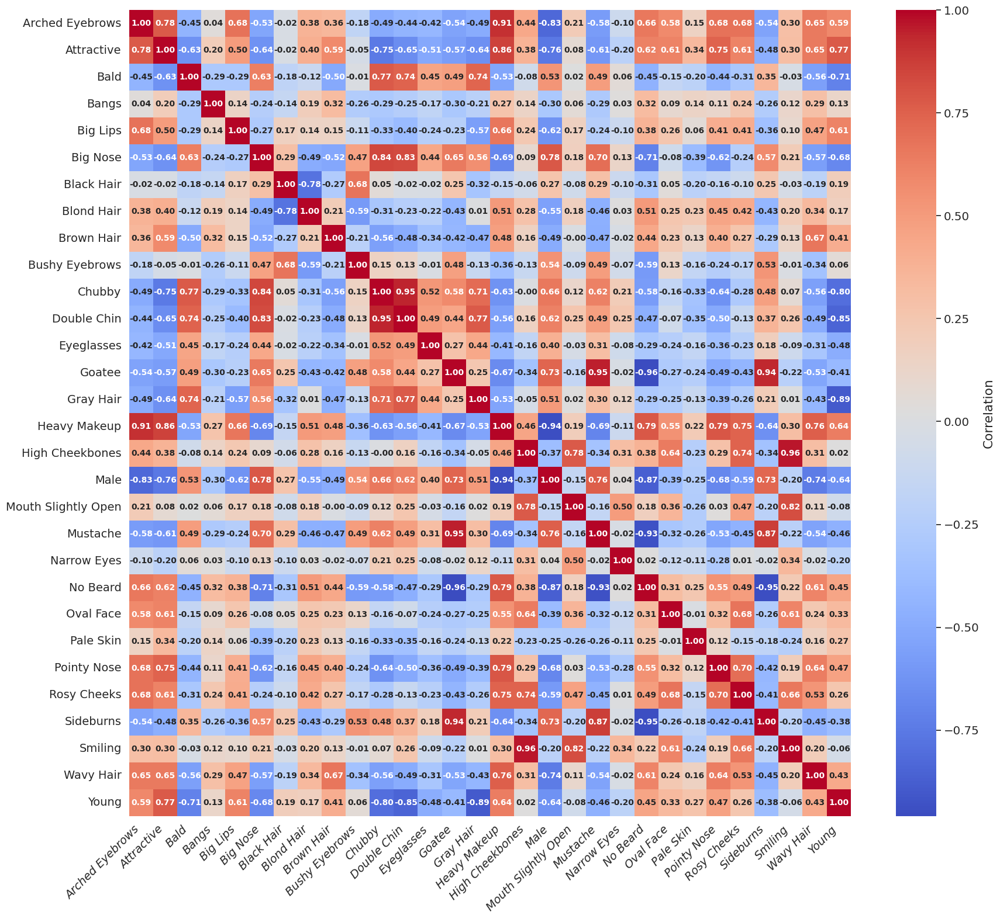

In [ ]:
import pandas as pd
import glob
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import os

# Path to attribute vectors
attr_vec_dir = 'results_encode_decode/20/attribute_analysis/selected_attribute_vectors'
vector_files = sorted(glob.glob(f"{attr_vec_dir}/*.npy"))  # sort file paths alphabetically

# Load vectors and names in alphabetical order
attr_vectors = {}
for file in vector_files:
    name = os.path.splitext(os.path.basename(file))[0]
    attr_vectors[name] = np.load(file)

# Sort attribute names alphabetically and remove "vector" from names for display
sorted_names = sorted(attr_vectors.keys())
display_names = [name.replace("vector", "").replace("_", " ").strip() for name in sorted_names]
df_attr = pd.DataFrame({name: attr_vectors[name] for name in sorted_names})

# Plot correlation matrix with seaborn
plt.figure(figsize=(18, 16))
corr = df_attr.corr()

sns.set(font_scale=1.3)  # Make all text bigger except cell text
ax = sns.heatmap(
    corr, 
    annot=True, 
    fmt=".2f", 
    cmap='coolwarm', 
    cbar_kws={'label': 'Correlation'}, 
    annot_kws={"size": 10 , "weight":'bold'}  # Make cell text smaller
)
ax.set_xticklabels(display_names, rotation=45, ha='right', fontsize=14, fontstyle='italic')  # Inclined bottom text
ax.set_yticklabels(display_names, fontsize=14)

plt.tight_layout()
#save figure
plt.savefig('results_encode_decode/20/attribute_analysis/correlation_matrix_alphabetical.png', dpi=400, bbox_inches='tight')

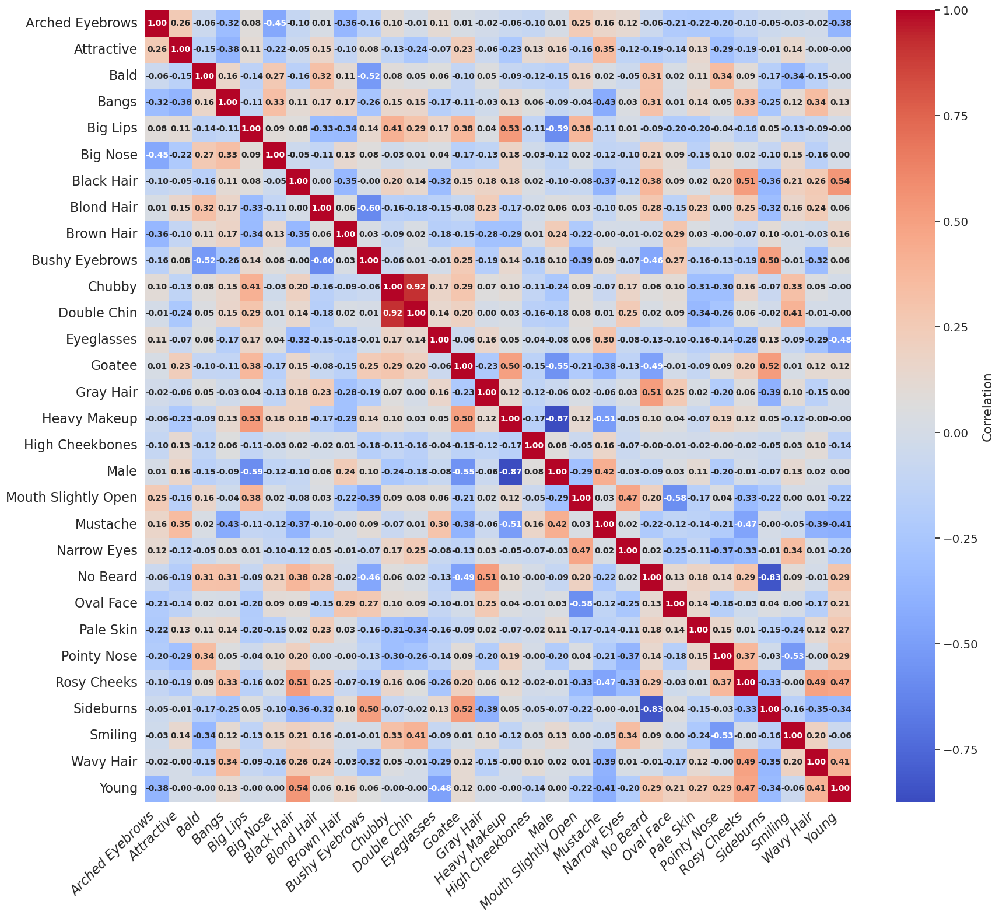

In [ ]:
import pandas as pd
import glob
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import os

# Path to attribute vectors
attr_vec_dir = 'results_encode_decode/20/attribute_analysis/selected_attribute_vectors'
save_dir = 'results_encode_decode/20/attribute_analysis/selected_orthogonalised_vectors'
os.makedirs(save_dir, exist_ok=True)
vector_files = sorted(glob.glob(f"{attr_vec_dir}/*.npy"))  # sort file paths alphabetically

# Load vectors and names in alphabetical order
attr_vectors = {}
for file in vector_files:
    name = os.path.splitext(os.path.basename(file))[0]
    attr_vectors[name] = np.load(file)

# Sort attribute names alphabetically and remove "vector" from names for display
sorted_names = sorted(attr_vectors.keys())
display_names = [name.replace("vector", "").replace("_", " ").strip() for name in sorted_names]
df_attr = pd.DataFrame({name: attr_vectors[name] for name in sorted_names})

# Compute correlation matrix
corr = df_attr.corr()

# Copy vectors for orthogonalization
new_attr_vectors = {name: attr_vectors[name].copy() for name in sorted_names}

for i, name_i in enumerate(sorted_names):
    for j, name_j in enumerate(sorted_names):
        if i == j:
            continue
        if 0.6 < abs(corr.loc[name_i, name_j]) < 0.9:
            v = new_attr_vectors[name_i]
            u = new_attr_vectors[name_j]
            proj = np.dot(v, u) / np.dot(u, u) * u
            new_attr_vectors[name_i] = v - proj

# Save orthogonalized vectors
for name, vec in new_attr_vectors.items():
    np.save(os.path.join(save_dir, f"{name}.npy"), vec)

# Create new DataFrame with orthogonalized vectors
df_attr_ortho = pd.DataFrame({name: new_attr_vectors[name] for name in sorted_names})

# Plot new correlation matrix
plt.figure(figsize=(18, 16))
corr_ortho = df_attr_ortho.corr()

sns.set(font_scale=1.3)
ax = sns.heatmap(
    corr_ortho,
    annot=True, 
    fmt=".2f", 
    cmap='coolwarm', 
    cbar_kws={'label': 'Correlation'}, 
    annot_kws={"size": 10, "weight": "bold"}
)
ax.set_xticklabels(display_names, rotation=45, ha='right', fontsize=16, fontstyle='italic')
ax.set_yticklabels(display_names, fontsize=16)
plt.tight_layout()
plt.savefig('results_encode_decode/20/attribute_analysis/correlation_matrix_orthogonalized.png', dpi=300, bbox_inches='tight')

In [28]:
###TRAINING DATA###        
full_dataset = utils.image_dataset_from_directory(
    './Dataset/all_images',
    seed=123,
    shuffle=True,
    image_size=(128, 128),
    batch_size=None,
    label_mode=None
)

normalization_layer = Rescaling(1./255)
full_dataset = full_dataset.map(lambda x: normalization_layer(x))

# Compute counts
total_images = 200_000
train_count = 180_000
val_count = 10_000
test_count = 10_000 #approximately

# Split manually
train_data = full_dataset.take(train_count)
val_test_split = full_dataset.skip(train_count)
val_data = val_test_split.take(val_count)
test_data = val_test_split.skip(val_count)

Found 202599 files.


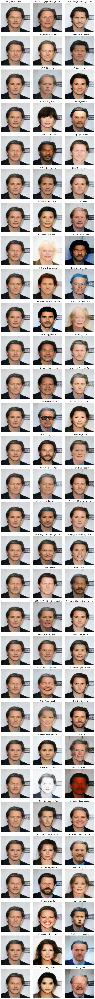

In [ ]:
import random

# Directory with orthogonalized attribute vectors
ortho_vec_dir = 'results_encode_decode/20/attribute_analysis/selected_orthogonalised_vectors'
ortho_vector_files = sorted(glob.glob(f"{ortho_vec_dir}/*.npy"))
ortho_attr_names = [os.path.splitext(os.path.basename(f))[0] for f in ortho_vector_files]

# Load orthogonalized vectors
ortho_attr_vectors = {name: np.load(f) for name, f in zip(ortho_attr_names, ortho_vector_files)}

# Get a random test image from val_data
# for img in val_data.take(1):
#     test_img = img.numpy()
#     break

# Encode the image to latent space
z_mean, z_log_var, z = vae.encoder(np.expand_dims(test_img, axis=0))
z = z.numpy()[0]

# Plot for each attribute
n_attr = len(ortho_attr_names)
n_cols = 3
n_rows = n_attr

plt.figure(figsize=(n_cols * 4, n_rows * 4))

for idx, attr_name in enumerate(ortho_attr_names):
    attr_vec = ortho_attr_vectors[attr_name]
    # Original reconstruction
    recon = vae.decoder(np.expand_dims(z, axis=0)).numpy()[0]
    # +3 attribute
    z_plus = z + 10 * attr_vec
    recon_plus = vae.decoder(np.expand_dims(z_plus, axis=0)).numpy()[0]
    # -3 attribute
    z_minus = z - 10 * attr_vec
    recon_minus = vae.decoder(np.expand_dims(z_minus, axis=0)).numpy()[0]
    
    # Add attribute name as a super-title for each row
    plt.subplot(n_rows, n_cols, idx * n_cols + 1)
    plt.imshow(np.clip(recon, 0, 1))
    plt.axis('off')
    plt.ylabel(attr_name, fontsize=16, rotation=0, labelpad=60, va='center')
    if idx == 0:
        plt.title('Original Reconstruct')
    
    plt.subplot(n_rows, n_cols, idx * n_cols + 2)
    plt.imshow(np.clip(recon_plus, 0, 1))
    plt.axis('off')
    plt.title(f'+3 {attr_name}')
    
    plt.subplot(n_rows, n_cols, idx * n_cols + 3)
    plt.imshow(np.clip(recon_minus, 0, 1))
    plt.axis('off')
    plt.title(f'-3 {attr_name}')

plt.tight_layout()
plt.show()
